## 적대적 생성 신경망(Generative Adversarial Networks)
### What is GAN
- GAN이란? 학습 데이터들의 분포를 학습해, 같은 분포에서 새로운 데이터를 생성할 수 있도록 DL 모델을 학습시키는 프레임워크
- 2014년 Ian Goodfellow가 개발했으며, Generative Adversarial Nets논문에서 처음 소개
- GAN은 생성자와 구분자로 구별되는 두가지 모델을 가지고 있는것이 특징
- 생성자의 역할은 실제 이미지로 착각되도록 정교한 이미지를 만드는 것이고, 구분자의 역할은 이미지를 보고 생성자에 의해 만들어진 이미지인지 실제 이미지인지 알아내는 것
- 모델을 학습하는 동안, 생성자는 더 진짜같은 가짜 이미지를 만들어내며 구분자를 속이려 하고, 구분자는 더 정확히 가짜/진짜 이미지를 구별할 수 있도록 노력
- 생성자가 학습 데이터들에서 직접 가져온 것처럼 보일정도로 완벽한 이미지를 만들어내고, 구분자가 생성자에서 나온 이미지를 50%의 확률로 가짜 혹은 진짜로 판별할 때, 균형상태에 도달
- $x$는 이미지로 표현되는 데이터
- $D(x)$는 구분자 신경망이고, 실제 학습데이터에서 가져온 $x$를 통과시켜 상수(scalar) 확률값을 결과로 출력
- 이때, 이미지 데이터의 경우, $D(x)$에는 3x64x64크기의 CHW 데이터가 입력
- 직관적으로 볼때, $D(x)$는 $x$가 학습데이터에서 가져온 것일 때 출력이 크고, 생성자가 만들어낸 $x$일때 작을 것
- $D(x)$는 전통적인 이진 분류기(binary classification)으로도 생각될 수 있음
- $z$를 정규분포에서 뽑은 잠재공간 벡터(laten space vector) : 정규분포를 따르는 n개의 원소를 가진 vector
- $G(z)$는 $z$벡터를 원하는 데이터 차원으로 대응시키는 신경망
- 이때 $G$의 목적은 $p_{data}$에서 얻을 수 있는 학습 데이터들의 분포를 추정하며, 모사한$p_g$의 분포를 이용해 가짜 데이터들을 생성
- $D(G(z))$는 $G$가 출력한 결과물이 실제 이미지일 0~1사이의 상수의 확률값
- $D$가 이미지의 참/거짓을 정확히 판별할 확률인 $logD(x)$에서 생성한 이미지를 $D$가 가짜로 판별할 확률인 $(log(1-D(G(z))))$를 최소화 시키려는 점에서, $D$와 $G$는 최대최소(minmax)게임을 하는 것과 같음
- 손실함수 : $\min\limits_{G}\max\limits_{D}V(D,G) = \Epsilon_{x~p_{data}(x)}[logD(x)] + \Epsilon_{z~p_z(z)}[log(1-D(G(z)))]$
- 이론적으로는, 이 최대최소게임은 $p_g = p_{data}$이고, 구분자에 입력된 데이터가 1/2의 무작위 확률로 참/거직이 판별될때 해답에 이름

### What is DCGAN
- GAN에서 직접적으로 파생된 모델로, 생성자와 구분자에서 합성곱 신경망(convolution)과 전치 합성곱 신경망(convolution-transpose)을 사용했다는 점이 차이
- 구분자에서는 convolution계층, batch norm계층, 그리고 LeakyReLU 활성함수가 사용
- 생성자는 convolutional-transpose 계층, 배치 정규화(batch norm)계층, 그리고 ReLU 활성함수가 사용
- 이떄, 전치 합성곱 신경망은 잠재공간 벡터로 하여금 이미지와 같은 차원을 갖도록 변환시켜주는 역할 수행

# Import Libraries

In [1]:
import os
import random
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.animation as animation
from IPython.display import HTML

import torch
import torch.nn as nn
import torch.nn.parallel
import torch.optim as optim
import torch.utils.data
import torchvision.datasets as dset
import torchvision.transforms as transforms
import torchvision.utils as vutils
device = torch.device('mps:0' if torch.backends.mps.is_available() else 'cpu')

manualSeed = 530
random.seed(manualSeed)
torch.manual_seed(manualSeed)

### 설정값
- dataroot : 데이터셋 폴더 경로
- workers : DataLoader에서 데이터를 불러올 때 사용할 쓰레드의 개수
- batch_size : 학습에 사용할 배치 크기
- image_size : 학습에 사용되는 이미지의 크기
- nc : 입력 이미지의 색 채널개수
- nz : 잠재공간 벡터의 원소들 개수
- ngf : 생성자를 통과할때 만들어질 특징 데이터의 채널개수
- ndf : 구분자를 통과할때 만들어질 특징 데이터의 채널개수
- num_epochs : 학습시킬 에폭 수
- lr : 모델의 학습률
- beta1 : Adam 옵티마이저에서 사용할 beta1 하이퍼파라미터 값
- ngpu : 사용가능한 gpu의 번호

In [2]:
dataroot = '/Volumes/T7/Dataset/celeba/img'
workers = 1
batch_size = 128
image_size = 64
nc = 3
nz = 100
ngf = 64
ndf = 64
num_epochs = 5
lr = 0.0002
beta1 = 0.5
ngpu = 1

# DataLoader

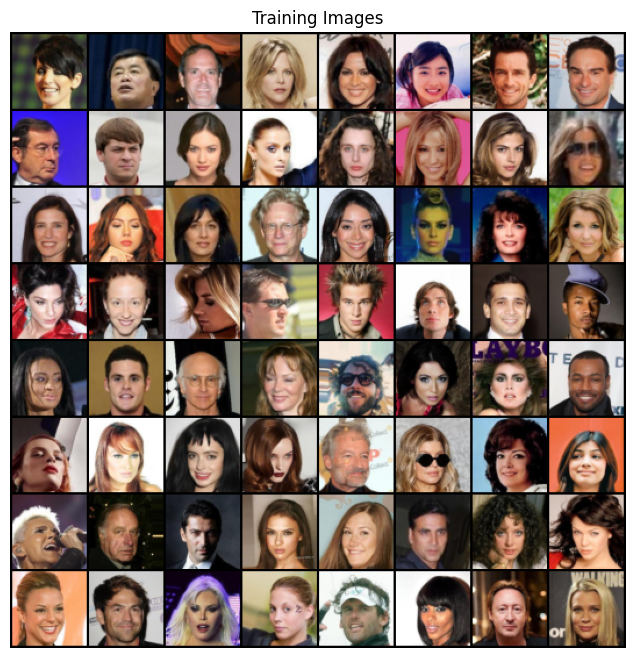

In [3]:
dataset = dset.ImageFolder(root=dataroot,
                           transform=transforms.Compose([
                               transforms.Resize(image_size),
                               transforms.CenterCrop(image_size),
                               transforms.ToTensor(),
                               transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5)),
                           ]))
# dataloader를 정의해봅시다
dataloader = torch.utils.data.DataLoader(dataset, batch_size=batch_size,
                                         shuffle=True, num_workers=workers)
real_batch = next(iter(dataloader))
plt.figure(figsize=(8,8))
plt.axis("off")
plt.title("Training Images")
plt.imshow(np.transpose(vutils.make_grid(real_batch[0].to(device)[:64], padding=2, normalize=True).cpu(),(1,2,0)))

# Model Architecture

### Weights initialize
- DCGAN 논문에서는 평균이 0이고 분산이 0.02인 정규분포를 사용해, 구분자와 생성자 모두 무작위 초기화를 진행하는 것이 좋다고 안내
- weight_init 함수는 매개변수로 모델을 입력받아 모든 합성곱 계층, 전치 합성곱 계층, 배치 정규화 계층을 조건대로 다시 초기화 수행

In [4]:
def weights_init(m):
    classname = m.__class__.__name__
    if classname.find('Conv') != -1:
        nn.init.normal_(m.weight.data, 0.0, 0.02)
    elif classname.find('BatchNorm') != -1:
        nn.init.normal_(m.weight.data, 1.0, 0.02)
        nn.init.constant_(m.bias.data, 0)

### 생성자
- 생성자 $G$는 잠재 공간 벡터 $z$를 데이터 공간으로 변환시키도록 설계
- 실제 모델에서는 스트라이드 2를 가진 전치 합성곱 계층들을 이어서 구성하는데, 각 전치 합성곱 계층 하나당 2차원 배치 정규화 계층과 relu 활성함수를 한 쌍으로 묶어서 사용
- 생성자의 마지막 출력 계층에서는 데이터를 tanh 함수에 통과시키는데, 이는 출력 값을 [-1, 1]사이의 범위로 조정하기 위함
- 이떄, 배치 정규화 계층을 주목할 필요가 있는데, DCGAN 논문에 의하면 이 계층이 경사하강법(gradient descent)의 흐름에 중요한 영향을 미치는 것으로 알려짐

![nn](https://tutorials.pytorch.kr/_images/dcgan_generator.png)

In [5]:
class Generator(nn.Module):
    def __init__(self, ngpu):
        super(Generator, self).__init__()
        self.ngpu = ngpu
        self.main = nn.Sequential(
            # 입력데이터 Z가 가장 처음 통과하는 전치 합성곱 계층입니다.
            nn.ConvTranspose2d( nz, ngf * 8, 4, 1, 0, bias=False),
            nn.BatchNorm2d(ngf * 8),
            nn.ReLU(True),
            # 위의 계층을 통과한 데이터의 크기. ``(ngf*8) x 4 x 4``
            nn.ConvTranspose2d(ngf * 8, ngf * 4, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf * 4),
            nn.ReLU(True),
            # 위의 계층을 통과한 데이터의 크기. ``(ngf*4) x 8 x 8``
            nn.ConvTranspose2d( ngf * 4, ngf * 2, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf * 2),
            nn.ReLU(True),
            # 위의 계층을 통과한 데이터의 크기. ``(ngf*2) x 16 x 16``
            nn.ConvTranspose2d( ngf * 2, ngf, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf),
            nn.ReLU(True),
            # 위의 계층을 통과한 데이터의 크기. ``(ngf) x 32 x 32``
            nn.ConvTranspose2d( ngf, nc, 4, 2, 1, bias=False),
            nn.Tanh()
            # 위의 계층을 통과한 데이터의 크기. ``(nc) x 64 x 64``
        )

    def forward(self, input):
        return self.main(input)

In [6]:
netG = Generator(ngpu).to(device)
if (device.type == 'cuda') and (ngpu > 1):
    netG = nn.DataParallel(netG, list(range(ngpu)))
netG.apply(weights_init)
print(netG)

Generator(
  (main): Sequential(
    (0): ConvTranspose2d(100, 512, kernel_size=(4, 4), stride=(1, 1), bias=False)
    (1): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU(inplace=True)
    (3): ConvTranspose2d(512, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (4): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (5): ReLU(inplace=True)
    (6): ConvTranspose2d(256, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (7): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (8): ReLU(inplace=True)
    (9): ConvTranspose2d(128, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (10): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (11): ReLU(inplace=True)
    (12): ConvTranspose2d(64, 3, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (13): Tanh()
  )
)


### 구분자
- 구분자 $D$는 입력 이미지가 진짜 이미지인지 판별하는 전통적인 이진 분류 신경망
- 이때 $D$는 3x64x64 이미지를 입력받아 Conv2d, BatchNorm2d, 그리고 LeakyReLU 계층을 통과시켜 데이터를 가공시키고, 마지막 출력에서 Sigmoid 함수를 이용하여 0~1 사이의 확률값으로 조정
- 이 아키텍쳐는 필요한 경우 더 다양한 레이어를 쌓을 수 있지만, 배치 정규화와 LeakyReLU, 특히 보폭이 있는(strided) 합성곱 계층을 사용하는 것에는 이유가 존재
- DCGAN 논문에서는 보폭이 있는 합성곱 계층을 사용하는 것이 신경망 내에서 스스로의 풀링(Pooling)함수를 학습하기 때문에, 데이터를 처리하는 과정에서 직접적으로 풀링 계층(MaxPool or AvgPooling)을 사용하는 것보다 더 유리하며 배치 정규화와 leaky relu 함수는 학습과정에서 $G$와 $D$가 더 효과적인 경사도(gradient)를 얻을 수 있음

In [7]:
class Discriminator(nn.Module):
    def __init__(self, ngpu):
        super(Discriminator, self).__init__()
        self.ngpu = ngpu
        self.main = nn.Sequential(
            # 입력 데이터의 크기는 ``(nc) x 64 x 64`` 입니다
            nn.Conv2d(nc, ndf, 4, 2, 1, bias=False),
            nn.LeakyReLU(0.2, inplace=True),
            # 위의 계층을 통과한 데이터의 크기. ``(ndf) x 32 x 32``
            nn.Conv2d(ndf, ndf * 2, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 2),
            nn.LeakyReLU(0.2, inplace=True),
            # 위의 계층을 통과한 데이터의 크기. ``(ndf*2) x 16 x 16``
            nn.Conv2d(ndf * 2, ndf * 4, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 4),
            nn.LeakyReLU(0.2, inplace=True),
            # 위의 계층을 통과한 데이터의 크기. ``(ndf*4) x 8 x 8``
            nn.Conv2d(ndf * 4, ndf * 8, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 8),
            nn.LeakyReLU(0.2, inplace=True),
            # 위의 계층을 통과한 데이터의 크기. ``(ndf*8) x 4 x 4``
            nn.Conv2d(ndf * 8, 1, 4, 1, 0, bias=False),
            nn.Sigmoid()
        )

    def forward(self, input):
        return self.main(input)

In [8]:
netD = Discriminator(ngpu).to(device)
if (device.type == 'cuda') and (ngpu > 1):
    netD = nn.DataParallel(netD, list(range(ngpu)))
netD.apply(weights_init)
print(netD)

Discriminator(
  (main): Sequential(
    (0): Conv2d(3, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (1): LeakyReLU(negative_slope=0.2, inplace=True)
    (2): Conv2d(64, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (3): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (4): LeakyReLU(negative_slope=0.2, inplace=True)
    (5): Conv2d(128, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (6): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (7): LeakyReLU(negative_slope=0.2, inplace=True)
    (8): Conv2d(256, 512, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (9): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (10): LeakyReLU(negative_slope=0.2, inplace=True)
    (11): Conv2d(512, 1, kernel_size=(4, 4), stride=(1, 1), bias=False)
    (12): Sigmoid()
  )
)


### 손실함수와 옵티마이저
- 손실함수로는 Binary Cross Entropy loss 사용
- $l(x,y) = L = {l_1, \ldots, l_N}^T, l_n = -[y_n \centerdot logx_n + (1 - y_n) \centerdot log(1 - x_n)]$
- 참 라벨은 1로 두고, 거짓 라벨은 0으로 설정
- 각 라벨의 ㄱ밧을 정한건 GAN 논문에서 사용된 값들로, GAN을 구성할때의 관례
- 옵티마이저는 $D$와 $G$ 각각 구성
- DCGAN 논문에 서술된 대로, 두 옵티마이저는 모두 Adam을 사용하고 학습률은 0.00002, Beta1 값은 0.5
- 학습이 진행되는 동안 생성자의 상태를 알아보기 위하여, 프로그램이 끝날 때까지 고정된 잠재 공간 벡터를 생성
- 이 벡터들 역시 가우시안 분포에서 추출
- 학습 과정을 반복하면서 $G$에 주기적으로 같은 잠재공간 벡터를 입력하면, 그 출력값을 기반으로 생성자의 상태를 확인

In [9]:
# ``BCELoss`` 함수의 인스턴스를 초기화합니다
criterion = nn.BCELoss()

# 생성자의 학습상태를 확인할 잠재 공간 벡터를 생성합니다
fixed_noise = torch.randn(64, nz, 1, 1, device=device)

# 학습에 사용되는 참/거짓의 라벨을 정합니다
real_label = 1.
fake_label = 0.

# G와 D에서 사용할 Adam옵티마이저를 생성합니다
optimizerD = optim.Adam(netD.parameters(), lr=lr, betas=(beta1, 0.999))
optimizerG = optim.Adam(netG.parameters(), lr=lr, betas=(beta1, 0.999))

# Training
### Part 1 - 구분자의 학습
- 구분자의 목적은 주어진 입력값이 진짜인지 가짜인지 판별하는 것
- 구분자는 "변화도(gradient)를 상승(ascending)시키며 훈련"
- 즉, $log(D(x)) + log(1 - D(G(z))$를 최대화
- 미니 배치(mini-batch)를 분리하여 사용한 개념 사용
- 먼저, 진짜 데이터들로만 이루어진 배치를 만들어 $D$에 통과시켜 그 출력값으로 $(log(D(x)))$의 손실값을 계산하고, 역전파 과정에서의 변화도들을 계산
- 두번째 스텝에서는 오로지 가짜 데이터들로만 이루어진 배치를 만들어 $D$에 통과시키고, 그 출력값으로 $(log(1-D(G(z))))$의 손실값을 계산해 역전파 변화도를 계산
- 이때, 두가지 스텝에서 나오는 변화도들은 축적(accumulate)시켜야함
### Part 2 - 생성자의 학습
- 오리지널 GAN에서 생선자는 $log(1 - D(G(z)))$를 최소화시키는 방향으로 학습했지만 충분한 변화도를 제공하지 못하여서 이를 해결하기 위해 $log(D(G(z)))$를 최대화 하는 방식으로 바꾸어서 진행
- 코드에서 구현하기 위해서는 Part1에서 한대로 구분자를 이용해 생성자의 출력값을 판별해주고, 진짜 라벨값을 이용해 $G$의 손실값을 계산
- 구해진 손실값으로 변화도를 구하고, 최종적으로 옵티마이저를 이용해 $G$의 가중치들을 업데이트
- 생성자가 만들어낸 가짜 이미지에 진짜 라벨을 사용하는 것이 직관적으로 위배가 될테지만, 이렇게 라벨을 바꿈으로써 $log(x)$라는 BCELoss의 일부분을 사용할 수 있게 함
- 마무리로 $G$의 훈련 상태를 알아보기 위하여 몇가지 통계적인 수치들과 fixed_noise를 통과시킨 결과를 화면에 출력
- Loss_D : 진짜 데이터와 가짜 데이터들 모두에서 구해진 손실값 $(log(D(x)) + log(1-D(G(z))))$
- Loss_G : 생성자의 손실값 $(log(D(G(z))))$
- D(x) : 구분자가 데이터를 판별한 확률값. 처음에는 1에 가까운 값이다가 G가 학습할수록 0.5 값에 수렴
- D(G(z)) : 가짜데이터들에 대한 구분자의 출력값. 처음에는 0에 가까운 값이다가, G가 학습할수록 0.5에 수렴

In [10]:
# 학습 과정

# 학습상태를 체크하기 위해 손실값들을 저장합니다
img_list = []
G_losses = []
D_losses = []
iters = 0

print("Starting Training Loop...")
# 에폭(epoch) 반복
for epoch in range(num_epochs):
    # 한 에폭 내에서 배치 반복
    for i, data in enumerate(dataloader, 0):

        ############################
        # (1) D 신경망을 업데이트 합니다: log(D(x)) + log(1 - D(G(z)))를 최대화 합니다
        ###########################
        ## 진짜 데이터들로 학습을 합니다
        netD.zero_grad()
        # 배치들의 사이즈나 사용할 디바이스에 맞게 조정합니다
        real_cpu = data[0].to(device)
        b_size = real_cpu.size(0)
        label = torch.full((b_size,), real_label,
                           dtype=torch.float, device=device)
        # 진짜 데이터들로 이루어진 배치를 D에 통과시킵니다
        output = netD(real_cpu).view(-1)
        # 손실값을 구합니다
        errD_real = criterion(output, label)
        # 역전파의 과정에서 변화도를 계산합니다
        errD_real.backward()
        D_x = output.mean().item()

        ## 가짜 데이터들로 학습을 합니다
        # 생성자에 사용할 잠재공간 벡터를 생성합니다
        noise = torch.randn(b_size, nz, 1, 1, device=device)
        # G를 이용해 가짜 이미지를 생성합니다
        fake = netG(noise)
        label.fill_(fake_label)
        # D를 이용해 데이터의 진위를 판별합니다
        output = netD(fake.detach()).view(-1)
        # D의 손실값을 계산합니다
        errD_fake = criterion(output, label)
        # 역전파를 통해 변화도를 계산합니다. 이때 앞서 구한 변화도에 더합니다(accumulate)
        errD_fake.backward()
        D_G_z1 = output.mean().item()
        # 가짜 이미지와 진짜 이미지 모두에서 구한 손실값들을 더합니다
        # 이때 errD는 역전파에서 사용되지 않고, 이후 학습 상태를 리포팅(reporting)할 때 사용합니다
        errD = errD_real + errD_fake
        # D를 업데이트 합니다
        optimizerD.step()

        ############################
        # (2) G 신경망을 업데이트 합니다: log(D(G(z)))를 최대화 합니다
        ###########################
        netG.zero_grad()
        label.fill_(real_label)  # 생성자의 손실값을 구하기 위해 진짜 라벨을 이용할 겁니다
        # 우리는 방금 D를 업데이트했기 때문에, D에 다시 가짜 데이터를 통과시킵니다.
        # 이때 G는 업데이트되지 않았지만, D가 업데이트 되었기 때문에 앞선 손실값가 다른 값이 나오게 됩니다
        output = netD(fake).view(-1)
        # G의 손실값을 구합니다
        errG = criterion(output, label)
        # G의 변화도를 계산합니다
        errG.backward()
        D_G_z2 = output.mean().item()
        # G를 업데이트 합니다
        optimizerG.step()

        # 훈련 상태를 출력합니다
        if i % 50 == 0:
            print('[%d/%d][%d/%d]\tLoss_D: %.4f\tLoss_G: %.4f\tD(x): %.4f\tD(G(z)): %.4f / %.4f'
                  % (epoch, num_epochs, i, len(dataloader),
                     errD.item(), errG.item(), D_x, D_G_z1, D_G_z2))

        # 이후 그래프를 그리기 위해 손실값들을 저장해둡니다
        G_losses.append(errG.item())
        D_losses.append(errD.item())

        # fixed_noise를 통과시킨 G의 출력값을 저장해둡니다
        if (iters % 500 == 0) or ((epoch == num_epochs-1) and (i == len(dataloader)-1)):
            with torch.no_grad():
                fake = netG(fixed_noise).detach().cpu()
            img_list.append(vutils.make_grid(fake, padding=2, normalize=True))

        iters += 1

Starting Training Loop...
[0/5][0/1583]	Loss_D: 1.7189	Loss_G: 3.4188	D(x): 0.3921	D(G(z)): 0.3900 / 0.0458
[0/5][50/1583]	Loss_D: 0.1502	Loss_G: 16.8153	D(x): 0.9373	D(G(z)): 0.0002 / 0.0000
[0/5][100/1583]	Loss_D: 0.1318	Loss_G: 16.7229	D(x): 0.9200	D(G(z)): 0.0000 / 0.0000
[0/5][150/1583]	Loss_D: 0.9784	Loss_G: 8.7121	D(x): 0.9562	D(G(z)): 0.4740 / 0.0019
[0/5][200/1583]	Loss_D: 0.3111	Loss_G: 3.2569	D(x): 0.8647	D(G(z)): 0.1122 / 0.0726
[0/5][250/1583]	Loss_D: 0.3163	Loss_G: 4.1805	D(x): 0.9173	D(G(z)): 0.1658 / 0.0243
[0/5][300/1583]	Loss_D: 1.4573	Loss_G: 9.4480	D(x): 0.9374	D(G(z)): 0.6561 / 0.0006
[0/5][350/1583]	Loss_D: 1.1266	Loss_G: 7.9084	D(x): 0.9252	D(G(z)): 0.5851 / 0.0014
[0/5][400/1583]	Loss_D: 1.1673	Loss_G: 6.1916	D(x): 0.8779	D(G(z)): 0.5805 / 0.0038
[0/5][450/1583]	Loss_D: 0.5686	Loss_G: 6.8153	D(x): 0.9411	D(G(z)): 0.3605 / 0.0021
[0/5][500/1583]	Loss_D: 0.4695	Loss_G: 6.1222	D(x): 0.9443	D(G(z)): 0.2962 / 0.0070
[0/5][550/1583]	Loss_D: 0.4340	Loss_G: 3.9537	D(x):

# Result

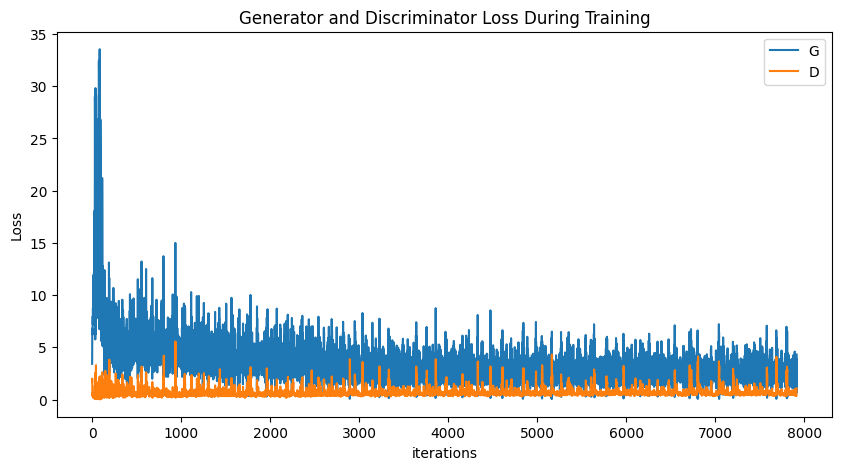

In [11]:
plt.figure(figsize=(10,5))
plt.title("Generator and Discriminator Loss During Training")
plt.plot(G_losses,label="G")
plt.plot(D_losses,label="D")
plt.xlabel("iterations")
plt.ylabel("Loss")
plt.legend()
plt.show()

# Visualize

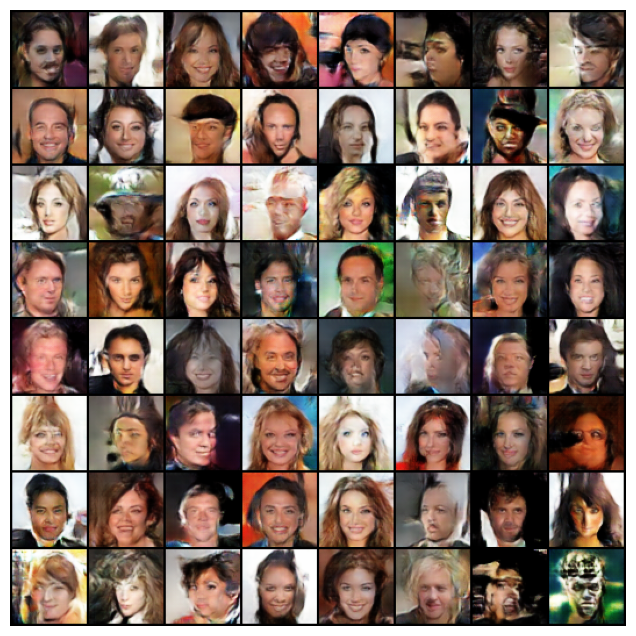

In [12]:
fig = plt.figure(figsize=(8,8))
plt.axis("off")
ims = [[plt.imshow(np.transpose(i,(1,2,0)), animated=True)] for i in img_list]
ani = animation.ArtistAnimation(fig, ims, interval=1000, repeat_delay=1000, blit=True)

HTML(ani.to_jshtml())

### 진짜 이미지 vs 가짜 이미지

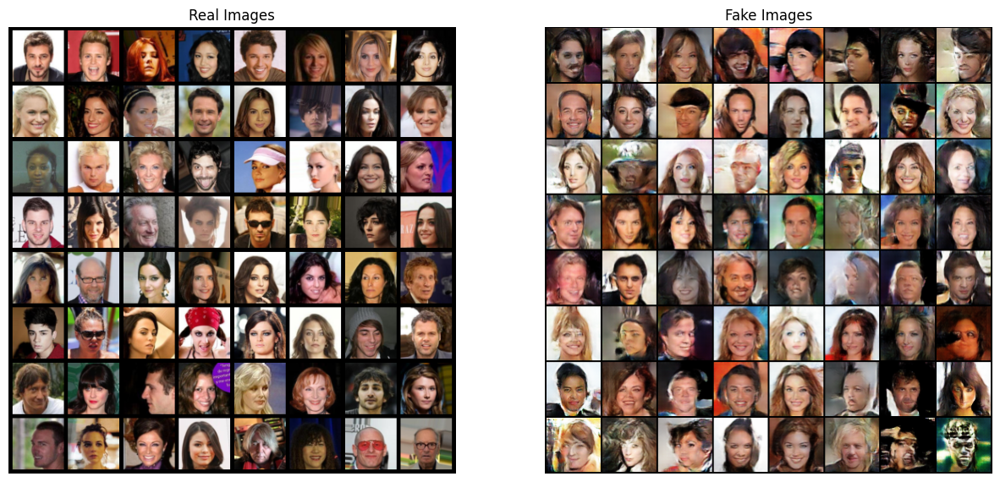

In [13]:
# dataloader에서 진짜 데이터들을 가져옵니다
real_batch = next(iter(dataloader))

# 진짜 이미지들을 화면에 출력합니다
plt.figure(figsize=(15,15))
plt.subplot(1,2,1)
plt.axis("off")
plt.title("Real Images")
plt.imshow(np.transpose(vutils.make_grid(real_batch[0].to(device)[:64], padding=5, normalize=True).cpu(),(1,2,0)))

# 가짜 이미지들을 화면에 출력합니다
plt.subplot(1,2,2)
plt.axis("off")
plt.title("Fake Images")
plt.imshow(np.transpose(img_list[-1],(1,2,0)))
plt.show()